# Applies Data Science Capstone

#### Matthew Sagianis

## Data Import

First, we need to import the data set provided by Seattle city

In [4]:
import numpy as np
import pandas as pd

In [5]:
import urllib.request
url = 'https://opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.csv'
filename = 'collisions.csv'
urllib.request.urlretrieve(url, filename)

#!wget -O collisions.csv https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv

('collisions.csv', <http.client.HTTPMessage at 0x7f3b36b36d68>)

In [6]:
df = pd.read_csv("collisions.csv", delimiter=",")
df.head()

,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,-122.356511,47.517361,1,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,...,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,-122.361405,47.702064,2,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,...,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
2,-122.317414,47.664028,3,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,...,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N
3,-122.318234,47.619927,4,327909,329409,EA03026,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,...,Wet,Dark - Street Lights On,NaN,NaN,NaN,0,Vehicle going straight hits pedestrian,0,0,N
4,-122.351724,47.560306,5,104900,104900,2671936,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,...,Ice,Dark - Street Lights On,NaN,9359012.0,Y,50,Fixed object,0,0,N


## Data Cleanup

Columns "EXCEPTRSNCODE" and "EXCEPTRSNDESC" contain incidents with insufficient information / location. We will drop those rows immediately, along with any rows where Severity = 0 (unknown)

In [7]:
df.drop(df[df['EXCEPTRSNCODE'] == 'NEI'].index , inplace=True)
df.drop(df[df['SEVERITYCODE'] == '0'].index , inplace=True)

Drop rows that are duplicates, or irrelevant to the scope of this project

In [8]:
df.drop(['OBJECTID','INCKEY','COLDETKEY','REPORTNO','STATUS','LOCATION','EXCEPTRSNCODE','EXCEPTRSNDESC',
         'SEVERITYDESC','INCDATE','SDOT_COLDESC','SDOTCOLNUM','ST_COLDESC','SEGLANEKEY','CROSSWALKKEY'], axis=1, inplace = True)


Look at remaining columns, determine if other columns need to be dropped due to missing or incomplete data

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 194396 entries, 0 to 221737
Data columns (total 25 columns):
X                  190946 non-null float64
Y                  190946 non-null float64
ADDRTYPE           194393 non-null object
INTKEY             66851 non-null float64
SEVERITYCODE       194395 non-null object
COLLISIONTYPE      190378 non-null object
PERSONCOUNT        194396 non-null int64
PEDCOUNT           194396 non-null int64
PEDCYLCOUNT        194396 non-null int64
VEHCOUNT           194396 non-null int64
INJURIES           194396 non-null int64
SERIOUSINJURIES    194396 non-null int64
FATALITIES         194396 non-null int64
INCDTTM            194396 non-null object
JUNCTIONTYPE       190897 non-null object
SDOT_COLCODE       194396 non-null float64
INATTENTIONIND     29628 non-null object
UNDERINFL          190396 non-null object
WEATHER            190198 non-null object
ROADCOND           190278 non-null object
LIGHTCOND          190128 non-null object
PEDROWNOTGRN

We will remove some columns that contain only a few data values.

In [9]:
df.drop(['INATTENTIONIND','PEDROWNOTGRNT','SPEEDING'], axis=1, inplace = True)

Now let's look to see how many remaining rows contain missing values.

In [8]:
df.isnull().sum()

X                    3450
Y                    3450
ADDRTYPE                3
INTKEY             127545
SEVERITYCODE            1
COLLISIONTYPE        4018
PERSONCOUNT             0
PEDCOUNT                0
PEDCYLCOUNT             0
VEHCOUNT                0
INJURIES                0
SERIOUSINJURIES         0
FATALITIES              0
INCDTTM                 0
JUNCTIONTYPE         3499
SDOT_COLCODE            0
UNDERINFL            4000
WEATHER              4198
ROADCOND             4118
LIGHTCOND            4268
ST_COLCODE             18
HITPARKEDCAR            0
dtype: int64

Since we're looking at specific location mapping, drop all null & "unknown" incidents without X/Y information, or weather/road/light conditions

In [10]:
df.dropna(subset=['X',"WEATHER","ROADCOND",'LIGHTCOND','SEVERITYCODE'],inplace=True)
df.drop(df[df['WEATHER'] == 'Unknown'].index , inplace=True)
df.drop(df[df['ROADCOND'] == 'Unknown'].index , inplace=True)
df.drop(df[df['LIGHTCOND'] == 'Unknown'].index , inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170907 entries, 0 to 221737
Data columns (total 22 columns):
X                  170907 non-null float64
Y                  170907 non-null float64
ADDRTYPE           170907 non-null object
INTKEY             63323 non-null float64
SEVERITYCODE       170907 non-null object
COLLISIONTYPE      170890 non-null object
PERSONCOUNT        170907 non-null int64
PEDCOUNT           170907 non-null int64
PEDCYLCOUNT        170907 non-null int64
VEHCOUNT           170907 non-null int64
INJURIES           170907 non-null int64
SERIOUSINJURIES    170907 non-null int64
FATALITIES         170907 non-null int64
INCDTTM            170907 non-null object
JUNCTIONTYPE       169819 non-null object
SDOT_COLCODE       170907 non-null float64
UNDERINFL          170907 non-null object
WEATHER            170907 non-null object
ROADCOND           170907 non-null object
LIGHTCOND          170907 non-null object
ST_COLCODE         170891 non-null object
HITPARKEDCA

UNDERINFL and HITPARKEDCAR column has values "Y", "N", "0", and "1". Assuming 0=No, and 1=Yes, replace all values

In [11]:
df["UNDERINFL"].replace({"N":'0', "Y": '1'},inplace=True)
df["UNDERINFL"] = df["UNDERINFL"].astype(float)
df["UNDERINFL"].groupby(df["UNDERINFL"]).count()
df["HITPARKEDCAR"].replace({"N":'0', "Y": '1'},inplace=True)
df["HITPARKEDCAR"] = df["HITPARKEDCAR"].astype(float)

Let's reformat some data types.
Severity codes are 0,1,2,2b and 3. Replace 2b with 2.5 and cast as float. State Col Codes can be labeled as -1 if unknown, and cast as float

In [12]:
df["SEVERITYCODE"].replace({"2b":"2.5"},inplace=True)
df = df.astype({'SEVERITYCODE': 'float64'})
df["ST_COLCODE"].replace({" ":"-1"},inplace=True)
df = df.astype({'ST_COLCODE': 'float64'})
df.dtypes

X                  float64
Y                  float64
ADDRTYPE            object
INTKEY             float64
SEVERITYCODE       float64
COLLISIONTYPE       object
PERSONCOUNT          int64
PEDCOUNT             int64
PEDCYLCOUNT          int64
VEHCOUNT             int64
INJURIES             int64
SERIOUSINJURIES      int64
FATALITIES           int64
INCDTTM             object
JUNCTIONTYPE        object
SDOT_COLCODE       float64
UNDERINFL          float64
WEATHER             object
ROADCOND            object
LIGHTCOND           object
ST_COLCODE         float64
HITPARKEDCAR       float64
dtype: object

Convert to datetime object

In [12]:
df["INCDTTM"] = pd.to_datetime(df["INCDTTM"])

## Visualizing Data Distribution

In [13]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
matplotlib.style.use('ggplot')


How many accidents do we have of each type?

In [14]:
df['SEVERITYCODE'].value_counts().to_frame()

,SEVERITYCODE
1.0,112288
2.0,55359
2.5,2932
3.0,328


Let's do some visualization of the data we have remaining, seeing if anything stands out quickly. First we'll look at Collision Address type

Text(0.5, 1.0, 'Collision Address Type')

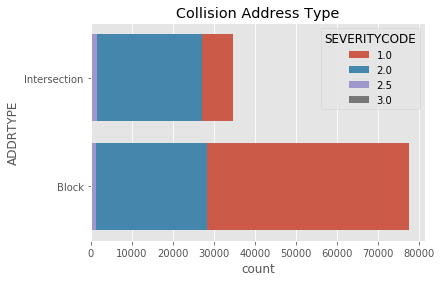

In [15]:
sns.countplot(y='ADDRTYPE',data=df, hue="SEVERITYCODE",dodge=False).set_title("Collision Address Type")


Let's similarly look at Collision Type

Text(0.5, 1.0, 'Collision Type')

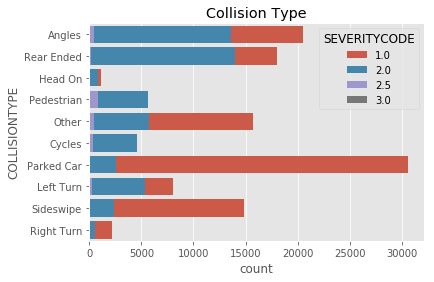

In [16]:
sns.countplot(y=df.COLLISIONTYPE, hue=df.SEVERITYCODE,dodge=False).set_title("Collision Type")

How about the individuals involved in accidents?

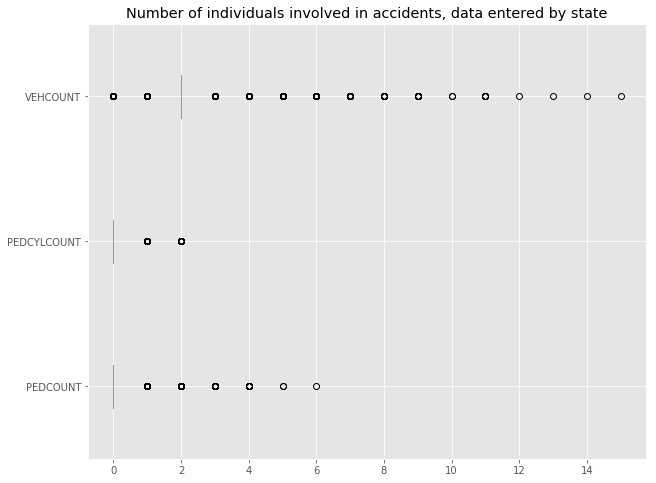

In [17]:
df[['PEDCOUNT','PEDCYLCOUNT','VEHCOUNT']].plot(kind='box',figsize=(10,8),vert=False)


plt.title("Number of individuals involved in accidents, data entered by state")
#plt.xlim(-4,20)

plt.show()




Does this data look any different when we look at total number of people involved in accidents?

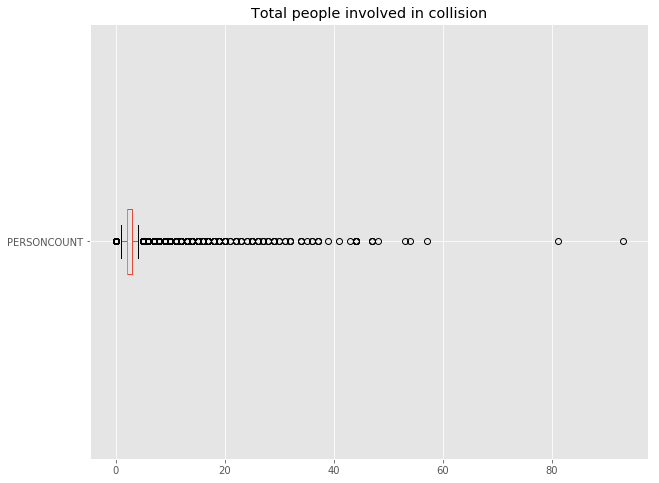

In [18]:
df['PERSONCOUNT'].plot(kind='box',figsize=(10,8),vert=False)

plt.title("Total people involved in collision")
#plt.xlim(-4,20)

plt.show()

Those are a lot of outliers, so let's zoom in only on the quartiles

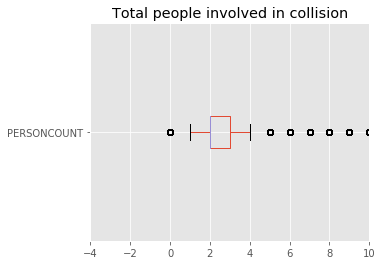

In [19]:
df['PERSONCOUNT'].plot(kind='box',figsize=(5,4),vert=False)

plt.title("Total people involved in collision")
plt.xlim(-4,10)

plt.show()

Seattle Department of Transportion assigns a code to each accident. For ease of viewing, we'll only look at the top 15 codes

Text(0.5, 1.0, 'SDOT Collision Code (Top 15)')

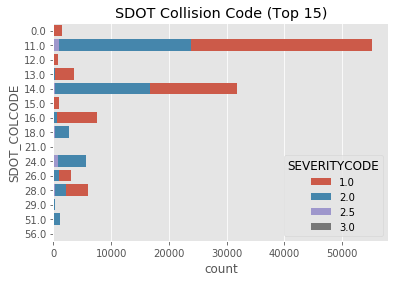

In [20]:
df2 = df['SDOT_COLCODE'].value_counts().to_frame().head(15)
df_SDOT = df[['SDOT_COLCODE',"SEVERITYCODE"]].copy()

indexlist = df2.index
df_SDOT = df_SDOT[df_SDOT["SDOT_COLCODE"].isin(indexlist) == True]
df_SDOT['SDOT_COLCODE'].value_counts().to_frame()
sns.countplot(y=df_SDOT.SDOT_COLCODE, hue=df_SDOT.SEVERITYCODE,dodge=False).set_title("SDOT Collision Code (Top 15)")

The State of WA also provides a separate code. Similarly, let's only look at the top 15.

Text(0.5, 1.0, 'State Collision Code (Top 15)')

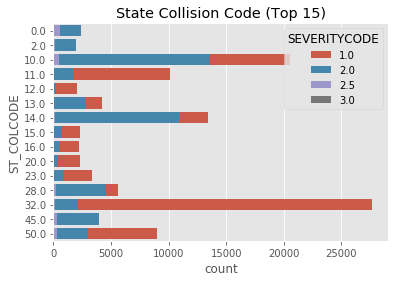

In [21]:
df2 = df['ST_COLCODE'].value_counts().to_frame().head(15)
df_ST = df[['ST_COLCODE',"SEVERITYCODE"]].copy()

indexlist = df2.index
df_ST = df_ST[df_ST["ST_COLCODE"].isin(indexlist) == True]
df_ST['ST_COLCODE'].value_counts().to_frame()
sns.countplot(y=df_ST.ST_COLCODE, hue=df_ST.SEVERITYCODE,dodge=False).set_title("State Collision Code (Top 15)")


Let's now look at Weather, Road Conditions, and Light Conditions

Text(0.5, 1.0, 'Weather')

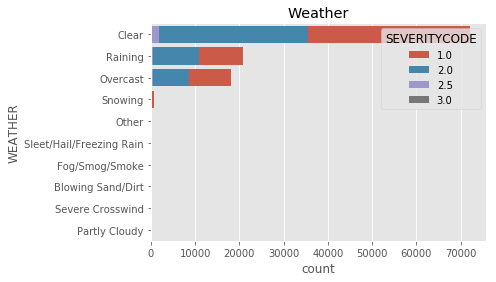

In [22]:
sns.countplot(y=df.WEATHER, hue=df.SEVERITYCODE,dodge=False).set_title("Weather")


Text(0.5, 1.0, 'Road Conditions')

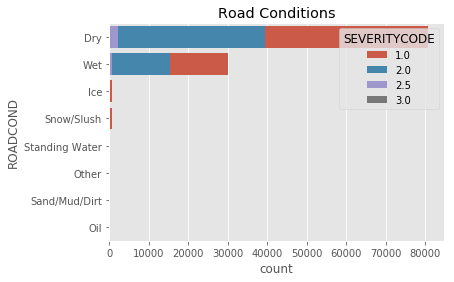

In [23]:
sns.countplot(y=df.ROADCOND, hue=df.SEVERITYCODE,dodge=False).set_title("Road Conditions")


Text(0.5, 1.0, 'Light Conditions')

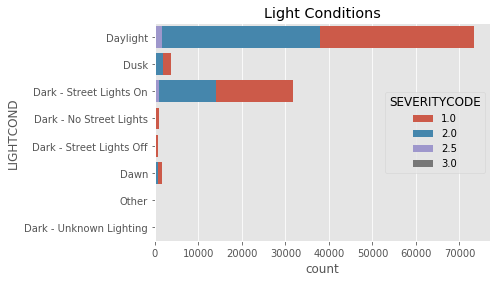

In [24]:
sns.countplot(y=df.LIGHTCOND, hue=df.SEVERITYCODE,dodge=False).set_title("Light Conditions")


In [25]:
df.describe()

,X,Y,INTKEY,SEVERITYCODE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,SDOT_COLCODE,UNDERINFL,ST_COLCODE,HITPARKEDCAR
count,170907.000000,170907.000000,63323.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170907.000000,170891.000000,170907.000000
mean,-122.330389,47.618901,37488.792666,1.353485,2.516170,0.046505,0.033656,1.967339,0.458319,0.018887,0.002054,14.585950,0.053988,21.975165,0.027711
std,0.029841,0.056813,51373.291860,0.495217,1.428633,0.222256,0.181957,0.587562,0.789346,0.177276,0.049471,6.662193,0.225996,14.801726,0.164144
min,-122.419032,47.495573,23808.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000
25%,-122.348235,47.573842,28667.000000,1.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,11.000000,0.000000,11.000000,0.000000
50%,-122.330348,47.614809,30018.000000,1.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,13.000000,0.000000,14.000000,0.000000
75%,-122.311952,47.663753,34020.000000,2.000000,3.000000,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,14.000000,0.000000,32.000000,0.000000
max,-122.238949,47.734142,757580.000000,3.000000,93.000000,6.000000,2.000000,15.000000,78.000000,41.000000,5.000000,87.000000,1.000000,88.000000,1.000000


In [26]:
df.describe(include=['object'])

,ADDRTYPE,COLLISIONTYPE,JUNCTIONTYPE,WEATHER,ROADCOND,LIGHTCOND
count,170907,170890,169819,170907,170907,170907
unique,2,10,7,10,8,8
top,Block,Angles,Mid-Block (not related to intersection),Clear,Dry,Daylight
freq,107584,34542,75148,109675,122604,113109


Now that we've cleaned up the data mostly, we can start to pull our desired dataset. For the purpose of this model, we will first define the feature variables for modeling. We will set those are "COLLISIONTYPE", "ADDRTYPE", "WEATHER", "ROADCOND", and "LIGHTCOND". As noticed earlier, there are many options for some of these categories, so we will group them together first.

# Balancing the data

Before we model our data, we want to balance the data. You'll notice below that there is a disproportional amount of Severity 1's, which will bias our ML model. We will downsample the data to have an equal number of Severity 1 & Severity 2. There will still be a disproportionately low number of 2.5 & 3's, but we don't want to cut the dataset down by too much.

In [27]:
df['SEVERITYCODE'].value_counts().to_frame()

,SEVERITYCODE
1.0,112288
2.0,55359
2.5,2932
3.0,328


In [28]:
from sklearn.utils import resample

dfSEV10 = df[df.SEVERITYCODE==1]
dfSEV20 = df[df.SEVERITYCODE==2]
dfSEV25 = df[df.SEVERITYCODE==2.5]
dfSEV30 = df[df.SEVERITYCODE==3]

bal_dfSEV10 = resample(dfSEV10,
                      replace=False,
                      n_samples=55359,
                      random_state=4)

bal_df = pd.concat([bal_dfSEV10,dfSEV20,dfSEV25,dfSEV30])

bal_df['SEVERITYCODE'].value_counts().to_frame()



,SEVERITYCODE
2.0,55359
1.0,55359
2.5,2932
3.0,328


## Feature Selection

In [29]:
Feature = bal_df[['COLLISIONTYPE','ADDRTYPE','WEATHER','ROADCOND','LIGHTCOND']].copy()
Feature.head()

,COLLISIONTYPE,ADDRTYPE,WEATHER,ROADCOND,LIGHTCOND
189303,Parked Car,Block,Clear,Dry,Daylight
205608,Parked Car,Block,Clear,Dry,Daylight
43493,Sideswipe,Block,Clear,Dry,Daylight
112210,Parked Car,Block,Clear,Dry,Daylight
15918,Angles,Intersection,Overcast,Wet,Dark - Street Lights On


In [30]:
Feature.describe()

,COLLISIONTYPE,ADDRTYPE,WEATHER,ROADCOND,LIGHTCOND
count,113963,113978,113978,113978,113978
unique,10,2,10,8,8
top,Angles,Block,Clear,Dry,Daylight
freq,24176,68286,73111,81718,75948


CollisionType has 10 uniques, of which they cannot be grouped. ADDRTYPE has 2. Weather, Road Conditions, and Light Conditions will be grouped below as the following:

In [31]:
Feature["WEATHER"].replace({"Blowing Sand/Dirt": 'Visibility Obstructed',
                            "Blowing Snow": 'Visibility Obstructed',
                            "Fog/Smog/Smoke": 'Visibility Obstructed',
                            "Clear": 'Visibility Unobstructed',
                            "Overcast": 'Visibility Unobstructed',
                            "Partly Cloudy": 'Visibility Unobstructed',
                            "Raining": 'Precipitation',
                            "Severe Crosswind": 'Visibility Obstructed',
                            "Sleet/Hail/Freezing Rain": 'Precipitation',
                            "Snowing": 'Precipitation',
                            "Other": 'Other - Weather'},inplace=True)

In [32]:
Feature["WEATHER"].value_counts().to_frame()

,WEATHER
Visibility Unobstructed,91133
Precipitation,22271
Visibility Obstructed,410
Other - Weather,164


In [33]:
Feature["ROADCOND"].replace({"Dry": 'Dry - Road',
                            "Ice": 'Wet - Slip',
                            "Oil": 'Wet - Slip',
                            "Sand/Mud/Dirt": 'Dry - Slip',
                            "Snow/Slush": 'Wet - Slip',
                            "Standing Water": 'Wet - Slip',
                            "Wet": 'Wet - Road',
                            "Other": 'Other - RoadCond'},inplace=True)

In [34]:
Feature["ROADCOND"].value_counts().to_frame()

,ROADCOND
Dry - Road,81718
Wet - Road,30887
Wet - Slip,1268
Other - RoadCond,69
Dry - Slip,36


In [35]:
Feature["LIGHTCOND"].replace({"Dark - No Street Lights": 'Dark',
                            "Dark - Street Lights Off": 'Dark',
                            "Dark - Street Lights On": 'Dark',
                            "Dark - Unknown Lighting": 'Dark',
                            "Dawn": 'Dusk/Dawn',
                            "Dusk": 'Dusk/Dawn',
                            "Other": 'Other - Light'},inplace=True)

In [36]:
Feature["LIGHTCOND"].value_counts().to_frame()

,LIGHTCOND
Daylight,75948
Dark,32457
Dusk/Dawn,5469
Other - Light,104


In [37]:
Feature.describe(include='object')

,COLLISIONTYPE,ADDRTYPE,WEATHER,ROADCOND,LIGHTCOND
count,113963,113978,113978,113978,113978
unique,10,2,4,5,4
top,Angles,Block,Visibility Unobstructed,Dry - Road,Daylight
freq,24176,68286,91133,81718,75948


Now that we've cleaned up the data, we can use one-hot encoding to convert categorical variables to binary and append them

In [38]:
Feature = pd.concat([Feature,pd.get_dummies(Feature['COLLISIONTYPE'])], axis=1)
Feature.drop(['COLLISIONTYPE'],axis=1,inplace=True)

Feature = pd.concat([Feature,pd.get_dummies(Feature['ADDRTYPE'])], axis=1)
Feature.drop(['ADDRTYPE'],axis=1,inplace=True)

Feature = pd.concat([Feature,pd.get_dummies(Feature['WEATHER'])], axis=1)
Feature.drop(['WEATHER'],axis=1,inplace=True)

Feature = pd.concat([Feature,pd.get_dummies(Feature['ROADCOND'])], axis=1)
Feature.drop(['ROADCOND'],axis=1,inplace=True)

Feature = pd.concat([Feature,pd.get_dummies(Feature['LIGHTCOND'])], axis=1)
Feature.drop(['LIGHTCOND'],axis=1,inplace=True)

Feature.head()

,Angles,Cycles,Head On,Left Turn,Other,Parked Car,Pedestrian,Rear Ended,Right Turn,Sideswipe,...,Visibility Unobstructed,Dry - Road,Dry - Slip,Other - RoadCond,Wet - Road,Wet - Slip,Dark,Daylight,Dusk/Dawn,Other - Light
189303,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
205608,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
43493,0,0,0,0,0,0,0,0,0,1,...,1,1,0,0,0,0,0,1,0,0
112210,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
15918,1,0,0,0,0,0,0,0,0,0,...,1,0,0,0,1,0,1,0,0,0


In [39]:
X = Feature
X[0:5]

,Angles,Cycles,Head On,Left Turn,Other,Parked Car,Pedestrian,Rear Ended,Right Turn,Sideswipe,...,Visibility Unobstructed,Dry - Road,Dry - Slip,Other - RoadCond,Wet - Road,Wet - Slip,Dark,Daylight,Dusk/Dawn,Other - Light
189303,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
205608,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
43493,0,0,0,0,0,0,0,0,0,1,...,1,1,0,0,0,0,0,1,0,0
112210,0,0,0,0,0,1,0,0,0,0,...,1,1,0,0,0,0,0,1,0,0
15918,1,0,0,0,0,0,0,0,0,0,...,1,0,0,0,1,0,1,0,0,0


In [40]:
y = bal_df['SEVERITYCODE'].values
y = y.astype(str)
len(y)
#y = y[0:10000]

113978

## Normalize Data

Normalize and Standardize data to give zero mean and unit variance

In [41]:
from sklearn import preprocessing

X = preprocessing.StandardScaler().fit(X.astype(float)).transform(X.astype(float))
X[0:5]

#X = X[0:10000]

array([[-0.51885884, -0.22188136, -0.11764654, -0.30339189, -0.37431355,
         2.32984477, -0.25388755, -0.50366309, -0.12282811, -0.30805851,
         0.81800178, -0.81800178, -0.03795981, -0.49279764, -0.06008471,
         0.50067712,  0.62830905, -0.01777499, -0.02461192, -0.60969253,
        -0.10606654, -0.63098559,  0.70762797, -0.22450245, -0.03022069],
       [-0.51885884, -0.22188136, -0.11764654, -0.30339189, -0.37431355,
         2.32984477, -0.25388755, -0.50366309, -0.12282811, -0.30805851,
         0.81800178, -0.81800178, -0.03795981, -0.49279764, -0.06008471,
         0.50067712,  0.62830905, -0.01777499, -0.02461192, -0.60969253,
        -0.10606654, -0.63098559,  0.70762797, -0.22450245, -0.03022069],
       [-0.51885884, -0.22188136, -0.11764654, -0.30339189, -0.37431355,
        -0.42921315, -0.25388755, -0.50366309, -0.12282811,  3.24613656,
         0.81800178, -0.81800178, -0.03795981, -0.49279764, -0.06008471,
         0.50067712,  0.62830905, -0.01777499, -0

# Classification

## Create Training Data and Testing Data

In [42]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.20, random_state=4)

print('Train set:', X_train.shape, y_train.shape)
print('Test set:', X_test.shape, y_test.shape)

Train set: (91182, 25) (91182,)
Test set: (22796, 25) (22796,)


Define a function for building the confusion Matrix

In [43]:
from sklearn.metrics import classification_report, confusion_matrix
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# K Nearest Neighbor (KNN)

In [44]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics


### If you run this code, you get max k = 11. 
###However this takes a while, so we will comment this out and just run as is.

#Ks = 15
#mean_acc = np.zeros((Ks-1))
#std_acc = np.zeros((Ks-1))
#ConfustionMx = [];
#for n in range(9,Ks):
#    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
#    yhat_knn=neigh.predict(X_test)
#    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat_knn)
#    print(n, mean_acc)
#print("Max Test Set Accuracy:", max(mean_acc))
#print("KNN for Max Accuracy occurs at k = ", np.argmax(mean_acc)+1)

neigh = KNeighborsClassifier(n_neighbors = 11).fit(X_train,y_train)
yhat_knn=neigh.predict(X_test)
print("Test Set Accuracy at k=11", metrics.accuracy_score(y_test, yhat_knn))

Test Set Accuracy at k=11 0.6340586067731181


Confusion matrix, without normalization
[[6385 4648    0    0]
 [3064 8069    0    0]
 [ 147  430    0    0]
 [  12   41    0    0]]


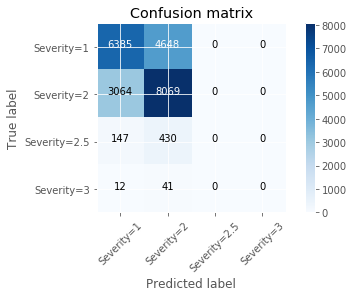

In [45]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, yhat_knn, labels=['1.0','2.0','2.5','3.0'])
np.set_printoptions(precision=4)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2','Severity=2.5','Severity=3'],normalize= False,  title='Confusion matrix')

# Decision Tree

In [46]:
#!conda install -c conda-forge pydotplus -y
#!conda install -c conda-forge python-graphviz -y

In [47]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.externals.six import StringIO
import pydotplus
import matplotlib.image as mpimg
from sklearn import tree

DecisionTrees's Accuracy:  0.6590629935076329


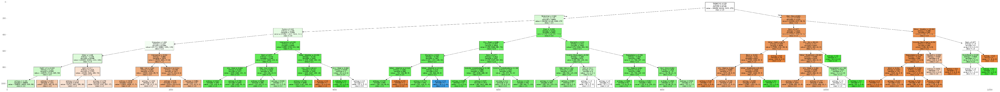

In [55]:
decisionTree = DecisionTreeClassifier(criterion="entropy", max_depth = 6)
decisionTree.fit(X_train,y_train)
yhat_dtree = decisionTree.predict(X_test)
print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y_test, yhat_dtree))
#predtree = yhat_dtree

dot_data = StringIO()
filename = "decisiontree.png"
featureNames = Feature.columns[0:25]
targetNames = df["SEVERITYCODE"].unique().tolist()
out=tree.export_graphviz(decisionTree,feature_names=featureNames, out_file=dot_data, class_names= np.unique(y_train), filled=True,  special_characters=True,rotate=False)  
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(filename)
img = mpimg.imread(filename)
plt.figure(figsize=(100, 200))
plt.imshow(img,interpolation='nearest')

Confusion matrix, without normalization
[[6202 4831    0    0]
 [2310 8822    1    0]
 [ 139  438    0    0]
 [  18   35    0    0]]


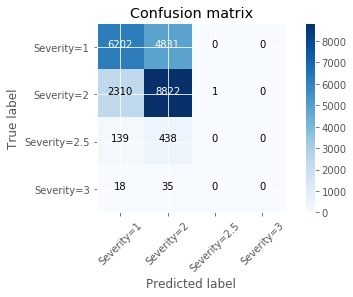

In [56]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, yhat_dtree, labels=['1.0','2.0','2.5','3.0'])
np.set_printoptions(precision=4)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2','Severity=2.5','Severity=3'],normalize= False,  title='Confusion matrix')

# Support Vector Machine

In [57]:
from sklearn import svm
clf = svm.SVC(kernel='rbf', gamma= 'auto')
clf.fit(X_train, y_train) 
yhat_svm = clf.predict(X_test)

print("Max Test Set Accuracy:", metrics.accuracy_score(y_test, yhat_svm))

Max Test Set Accuracy: 0.6616072995262327


Confusion matrix, without normalization
[[6588 4445    0    0]
 [2639 8494    0    0]
 [ 150  427    0    0]
 [  20   33    0    0]]


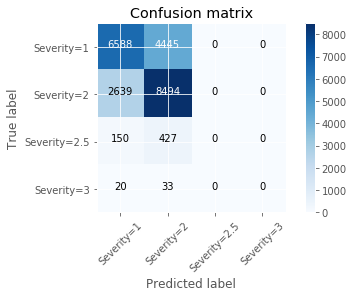

In [58]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, yhat_svm, labels=['1.0','2.0','2.5','3.0'])
np.set_printoptions(precision=4)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2','Severity=2.5','Severity=3'],normalize= False,  title='Confusion matrix')

# Logistic Regression

In [59]:
from sklearn.linear_model import LogisticRegression

LR = LogisticRegression(C=0.01, solver='liblinear').fit(X_train,y_train)
yhat_LR = LR.predict(X_test)

print("Max Test Set Accuracy:", metrics.accuracy_score(y_test, yhat_LR))

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Max Test Set Accuracy: 0.6589313914721882


Confusion matrix, without normalization
[[6203 4830    0    0]
 [2315 8818    0    0]
 [ 139  438    0    0]
 [  18   35    0    0]]


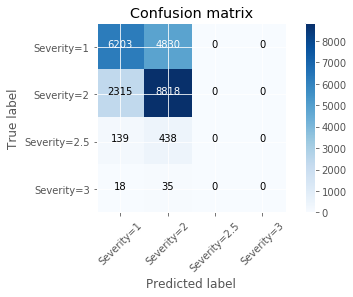

In [60]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, yhat_LR, labels=['1.0','2.0','2.5','3.0'])
np.set_printoptions(precision=4)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2','Severity=2.5','Severity=3'],normalize= False,  title='Confusion matrix')

# Model Evaluation

In [61]:
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss



In [62]:
KNN_F1 = f1_score(y_test, yhat_knn, average='weighted').round(3)
KNN_Jaccard = jaccard_similarity_score(y_test, yhat_knn).round(3)
print("kNN 7 F1 score:", KNN_F1)
print("Jaccard Similarity Score:",KNN_Jaccard)

kNN 7 F1 score: 0.623
Jaccard Similarity Score: 0.634


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [63]:
Decision_F1 = f1_score(y_test, yhat_dtree, average='weighted').round(3)
Decision_Jaccard = jaccard_similarity_score(y_test,yhat_dtree).round(3)

print("Decision Tree F1 score:", Decision_F1)
print("Decision Tree Jaccard Similarity Score:", Decision_Jaccard)

Decision Tree F1 score: 0.646
Decision Tree Jaccard Similarity Score: 0.659


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [64]:
SVM_F1 = f1_score(y_test,yhat_svm, average='weighted').round(3)
SVM_Jaccard = jaccard_similarity_score(y_test,yhat_svm).round(3)

print("SVM F1 score:", SVM_F1)
print("SVM Jaccard Similarity Score:", SVM_Jaccard)

SVM F1 score: 0.65
SVM Jaccard Similarity Score: 0.662


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [65]:
LR_yhat_prob = LR.predict_proba(X_test)

LR_F1 = f1_score(y_test,yhat_LR, average='weighted').round(3)
LR_Jaccard = jaccard_similarity_score(y_test,yhat_LR).round(3)
LR_LogLoss = log_loss(y_test, LR_yhat_prob).round(3)

print("LR F1 score:", LR_F1)
print("LR Jaccard Similarity Score:", LR_Jaccard)
print("LR Log Loss:", LR_LogLoss)

LR F1 score: 0.646
LR Jaccard Similarity Score: 0.659
LR Log Loss: 0.694


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [66]:
testarray= np.array([['KNN',KNN_Jaccard,KNN_F1,'NA'],
                    ['Decision Tree',Decision_Jaccard,Decision_F1,'NA'],
                    ['SVM',SVM_Jaccard,SVM_F1,'NA'],
                    ['LogisticRegression',LR_Jaccard,LR_F1,LR_LogLoss]]
                   )

ReportDF = pd.DataFrame(data=testarray,columns=['Algorithm','Jaccard','F1-score','LogLoss'])
ReportDF.style.hide_index()

Algorithm,Jaccard,F1-score,LogLoss
KNN,0.634,0.623,NA
Decision Tree,0.659,0.646,NA
SVM,0.662,0.65,NA
LogisticRegression,0.659,0.646,0.694


# Improving Accuracy

We have very few incidents of Severity 2.5 & Severity 3, and the confusion matrix's show that almost all of them are being incorrectly identified. Let's re-run the same dataset, after dropping those out

In [83]:
bal_df2 = bal_df.copy()
bal_df2.drop(bal_df2[bal_df2['SEVERITYCODE'] == 2.5].index , inplace=True)
bal_df2.drop(bal_df2[bal_df2['SEVERITYCODE'] == 3.0].index , inplace=True)

bal_df2['SEVERITYCODE'].value_counts().to_frame()

,SEVERITYCODE
2.0,55359
1.0,55359


In [87]:
Feature2 = bal_df2[['COLLISIONTYPE','ADDRTYPE','WEATHER','ROADCOND','LIGHTCOND']].copy()
Feature2.head()
Feature2["WEATHER"].replace({"Blowing Sand/Dirt": 'Visibility Obstructed',
                            "Blowing Snow": 'Visibility Obstructed',
                            "Fog/Smog/Smoke": 'Visibility Obstructed',
                            "Clear": 'Visibility Unobstructed',
                            "Overcast": 'Visibility Unobstructed',
                            "Partly Cloudy": 'Visibility Unobstructed',
                            "Raining": 'Precipitation',
                            "Severe Crosswind": 'Visibility Obstructed',
                            "Sleet/Hail/Freezing Rain": 'Precipitation',
                            "Snowing": 'Precipitation',
                            "Other": 'Other - Weather'},inplace=True)
Feature2["ROADCOND"].replace({"Dry": 'Dry - Road',
                            "Ice": 'Wet - Slip',
                            "Oil": 'Wet - Slip',
                            "Sand/Mud/Dirt": 'Dry - Slip',
                            "Snow/Slush": 'Wet - Slip',
                            "Standing Water": 'Wet - Slip',
                            "Wet": 'Wet - Road',
                            "Other": 'Other - RoadCond'},inplace=True)
Feature2["LIGHTCOND"].replace({"Dark - No Street Lights": 'Dark',
                            "Dark - Street Lights Off": 'Dark',
                            "Dark - Street Lights On": 'Dark',
                            "Dark - Unknown Lighting": 'Dark',
                            "Dawn": 'Dusk/Dawn',
                            "Dusk": 'Dusk/Dawn',
                            "Other": 'Other - Light'},inplace=True)
Feature2 = pd.concat([Feature2,pd.get_dummies(Feature2['COLLISIONTYPE'])], axis=1)
Feature2.drop(['COLLISIONTYPE'],axis=1,inplace=True)

Feature2 = pd.concat([Feature2,pd.get_dummies(Feature2['ADDRTYPE'])], axis=1)
Feature2.drop(['ADDRTYPE'],axis=1,inplace=True)

Feature2 = pd.concat([Feature2,pd.get_dummies(Feature2['WEATHER'])], axis=1)
Feature2.drop(['WEATHER'],axis=1,inplace=True)

Feature2 = pd.concat([Feature2,pd.get_dummies(Feature2['ROADCOND'])], axis=1)
Feature2.drop(['ROADCOND'],axis=1,inplace=True)

Feature2 = pd.concat([Feature2,pd.get_dummies(Feature2['LIGHTCOND'])], axis=1)
Feature2.drop(['LIGHTCOND'],axis=1,inplace=True)

X2 = Feature2
y2 = bal_df2['SEVERITYCODE'].values
y2 = y2.astype(str)

X2 = preprocessing.StandardScaler().fit(X2.astype(float)).transform(X2.astype(float))

In [88]:
X2_train, X2_test, y2_train, y2_test = train_test_split( X2, y2, test_size=0.20, random_state=4)

print('Train set:', X2_train.shape, y2_train.shape)
print('Test set:', X2_test.shape, y2_test.shape)

Train set: (88574, 25) (88574,)
Test set: (22144, 25) (22144,)


### KNN Test

In [89]:
neigh2 = KNeighborsClassifier(n_neighbors = 11).fit(X2_train,y2_train)
y2hat_knn=neigh.predict(X2_test)
print("Test Set Accuracy at k=11", metrics.accuracy_score(y2_test, y2hat_knn))

Test Set Accuracy at k=11 0.6616690751445087


Confusion matrix, without normalization
[[7114 3910]
 [3582 7538]]


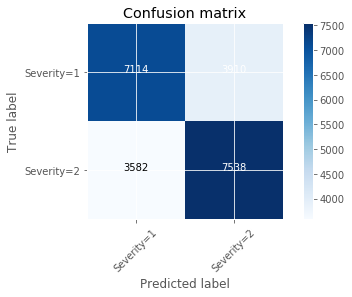

In [90]:
# Compute confusion matrix
cnf2_matrix = confusion_matrix(y2_test, y2hat_knn, labels=['1.0','2.0'])
np.set_printoptions(precision=2)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf2_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Confusion matrix')

### Decision Tree

In [91]:
decisionTree2 = DecisionTreeClassifier(criterion="entropy", max_depth = 6)
decisionTree2.fit(X2_train,y2_train)
y2hat_dtree = decisionTree.predict(X2_test)
print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y2_test, y2hat_dtree))

DecisionTrees's Accuracy:  0.6832550578034682


Confusion matrix, without normalization
[[6213 4811]
 [2202 8917]]


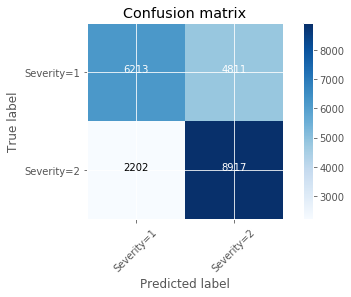

In [93]:
# Compute confusion matrix
cnf2_matrix = confusion_matrix(y2_test, y2hat_dtree, labels=['1.0','2.0'])
np.set_printoptions(precision=2)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf2_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Confusion matrix')

### SVM

In [92]:
clf2 = svm.SVC(kernel='rbf', gamma= 'auto')
clf2.fit(X2_train, y2_train) 
y2hat_svm = clf.predict(X2_test)

print("Max Test Set Accuracy:", metrics.accuracy_score(y2_test, y2hat_svm))

Max Test Set Accuracy: 0.6856936416184971


Confusion matrix, without normalization
[[6593 4431]
 [2529 8591]]


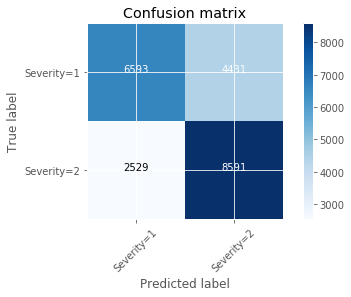

In [94]:
# Compute confusion matrix
cnf2_matrix = confusion_matrix(y2_test, y2hat_svm, labels=['1.0','2.0'])
np.set_printoptions(precision=2)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf2_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Confusion matrix')

### Logistic Regression

In [95]:
LR2 = LogisticRegression(C=0.01, solver='liblinear').fit(X2_train,y2_train)
y2hat_LR = LR.predict(X2_test)

print("Max Test Set Accuracy:", metrics.accuracy_score(y2_test, y2hat_LR))

Max Test Set Accuracy: 0.6833002167630058


Confusion matrix, without normalization
[[6215 4809]
 [2204 8916]]


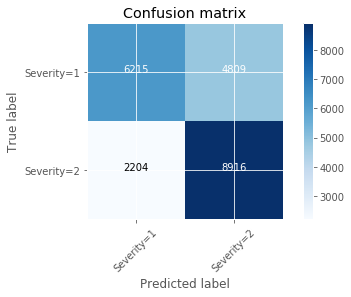

In [96]:
# Compute confusion matrix
cnf2_matrix = confusion_matrix(y2_test, y2hat_LR, labels=['1.0','2.0'])
np.set_printoptions(precision=2)


# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf2_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Confusion matrix')

### Model Evaluation

In [98]:
KNN2_F1 = f1_score(y2_test, y2hat_knn, average='weighted').round(3)
KNN2_Jaccard = jaccard_similarity_score(y2_test, y2hat_knn).round(3)

Decision2_F1 = f1_score(y2_test, y2hat_dtree, average='weighted').round(3)
Decision2_Jaccard = jaccard_similarity_score(y2_test,y2hat_dtree).round(3)

SVM2_F1 = f1_score(y2_test,y2hat_svm, average='weighted').round(3)
SVM2_Jaccard = jaccard_similarity_score(y2_test,y2hat_svm).round(3)

LR_y2hat_prob = LR2.predict_proba(X2_test)
LR2_F1 = f1_score(y2_test,y2hat_LR, average='weighted').round(3)
LR2_Jaccard = jaccard_similarity_score(y2_test,y2hat_LR).round(3)
LR2_LogLoss = log_loss(y2_test, LR_y2hat_prob).round(3)

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [99]:
testarray= np.array([['KNN',KNN2_Jaccard,KNN2_F1,'NA'],
                    ['Decision Tree',Decision2_Jaccard,Decision2_F1,'NA'],
                    ['SVM',SVM2_Jaccard,SVM2_F1,'NA'],
                    ['LogisticRegression',LR2_Jaccard,LR2_F1,LR2_LogLoss]]
                   )

Report2DF = pd.DataFrame(data=testarray,columns=['Algorithm','Jaccard','F1-score','LogLoss'])
Report2DF.style.hide_index()

Algorithm,Jaccard,F1-score,LogLoss
KNN,0.662,0.662,NA
Decision Tree,0.683,0.679,NA
SVM,0.686,0.683,NA
LogisticRegression,0.683,0.679,0.578


## Visualizing Accident Locations using Folium

In [100]:
url2 = 'http://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.geojson'
filename2 = 'SeattleCollision.geojson'
urllib.request.urlretrieve(url2, filename2)

#!wget --quiet  http://data-seattlecitygis.opendata.arcgis.com/datasets/5b5c745e0f1f48e7a53acec63a0022ab_0.geojson -O SeattleCollision.geojson
print('GeoJSON file downloaded!')

GeoJSON file downloaded!


In [2]:
#!conda install -c conda-forge folium=0.5.0 --yes
import folium
from folium import plugins
from folium.plugins import HeatMap
print('Folium installed and imported!')


Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - folium=0.5.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    certifi-2020.6.20          |   py36h9880bd3_2         151 KB  conda-forge
    vincent-0.4.4              |             py_1          28 KB  conda-forge
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    altair-4.1.0               |             py_1         614 KB  conda-forge
    folium-0.5.0               |             py_0          45 KB  conda-forge
    branca-0.4.1               |             py_0          26 KB  conda-forge
    openssl-1.1.1h             |       h516909a_0         2.1 MB  conda-forge
    ------------------------------------------------------------
                       

Severity = All Full map

In [14]:
world_map = folium.Map(location=[47.6062, -122.3321], zoom_start=12, width = '40%', height = '80%')

heat_data = [[row['Y'],row['X'],row['SEVERITYCODE']] for index, row in df.iterrows()]

HeatMap(heat_data,min_opacity = 0,radius = 10,max_val=6).add_to(world_map)
world_map

Severity = 1 Full map

In [15]:
world_geo_1 = r'SeattleCollision.geojson' # geojson file
# create blank map, centered on Seattle
world_map_1 = folium.Map(location=[47.6062, -122.3321], zoom_start=12, width = '40%', height = '80%')
df_SEV10 = df[df.SEVERITYCODE==1]
heat_data_SEV10 = [[row['Y'],row['X'],row['SEVERITYCODE']] for index, row in df_SEV10.iterrows()]
#heat_data_SEV20 = heat_data[heat_data.SEVERITYCODE==2]
#heat_data_SEV25 = heat_data[heat_data.SEVERITYCODE==2.5]
#heat_data_SEV30 = heat_data[heat_data.SEVERITYCODE==3]

HeatMap(heat_data_SEV10,min_opacity = 0,radius = 10,max_val=6).add_to(world_map_1)
world_map_1

Severity = 2 Full map

In [16]:
world_map_2 = folium.Map(location=[47.6062, -122.3321], zoom_start=12, width = '40%', height = '80%')
df_SEV20 = df[df.SEVERITYCODE==2]
heat_data_SEV20 = [[row['Y'],row['X'],row['SEVERITYCODE']] for index, row in df_SEV20.iterrows()]

#heat_data_SEV25 = heat_data[heat_data.SEVERITYCODE==2.5]
#heat_data_SEV30 = heat_data[heat_data.SEVERITYCODE==3]

HeatMap(heat_data_SEV20,min_opacity = 0,radius = 10,max_val=6).add_to(world_map_2)
world_map_2

Severity = 2.5 Full Map

In [17]:
world_map_25 = folium.Map(location=[47.6062, -122.3321], zoom_start=12, width = '40%', height = '80%')
df_SEV25 = df[df.SEVERITYCODE==2.5]
heat_data_SEV25 = [[row['Y'],row['X'],row['SEVERITYCODE']] for index, row in df_SEV25.iterrows()]

#heat_data_SEV30 = heat_data[heat_data.SEVERITYCODE==3]

HeatMap(heat_data_SEV25,min_opacity = .4,radius = 10,max_val=6).add_to(world_map_25)
world_map_25

Severity = 3 Full Map

In [18]:
world_map_3 = folium.Map(location=[47.6062, -122.3321], zoom_start=12, width = '40%', height = '80%')
df_SEV30 = df[df.SEVERITYCODE==3]
heat_data_SEV30 = [[row['Y'],row['X'],row['SEVERITYCODE']] for index, row in df_SEV30.iterrows()]

#heat_data_SEV30 = heat_data[heat_data.SEVERITYCODE==3]

HeatMap(heat_data_SEV30,min_opacity = 0.4,radius = 10,max_val=6).add_to(world_map_3)
world_map_3